# Proposed API

### geodesics/utils.py

In [1]:
"""
Utilities for Geodesic Module

Unit System: M-Units => G = c = M = 1

"""
import subprocess as sb
import warnings

import numpy as np
import regex as re


def _energy(E, q, p, a, mu):
    """
    Utility function to compute Energy of the test particle,
    using `scipy.optimize.fsolve`

    Parameters
    ----------
    E : float
        Variable, which `scipy.optimize.fsolve` solves for
    q : array_like
        Length-3 Array, containing the initial 3-Position
    p: array_like
        Length-3 Array, containing the initial 3-Momentum
    a : float
        Dimensionless Spin Parameter of the Black Hole
        ``0 <= a <= 1``
    mu : float
        Rest Mass of the test particle
        ``mu = 0.`` for Null Geodesics
        ``mu = -1`` for Timelike Geodesics

    Returns
    -------
    float
        Energy of the test particle

    """
    return (
        a ** 4 * (-(E ** 2) + mu ** 2 + 2 * p[0] ** 2)
        + 8 * a * E * p[2] * q[0]
        - a ** 2
        * (
            2 * p[2] ** 2
            - 2 * p[1] ** 2
            + q[0]
            * (
                mu ** 2 * (2 - 3 * q[0])
                - 4 * p[0] ** 2 * (-2 + q[0])
                + E ** 2 * (2 + 3 * q[0])
            )
        )
        + 2
        * q[0]
        * (
            p[1] ** 2 * (-2 + q[0])
            + q[0]
            * (
                p[0] ** 2 * (-2 + q[0]) ** 2
                + q[0] * (mu ** 2 * (-2 + q[0]) - E ** 2 * q[0])
            )
        )
        - (a ** 2 + (-2 + q[0]) * q[0])
        * (
            a ** 2 * (E - mu) * (E + mu) * np.cos(2 * q[1])
            - 2 * p[2] ** 2 * (1 / (np.sin(q[1]) ** 2))
        )
    ) / (
        (a ** 2 + (-2 + q[0]) * q[0])
        * (a ** 2 + 2 * q[0] ** 2 + a ** 2 * np.cos(2 * q[1]))
    )


def _sphToCart(r, th, ph):
    """
    Utility function to convert Spherical Polar 
    Coordinates to Cartesian Coordinates

    """
    xs = r * np.sin(th) * np.cos(ph)
    ys = r * np.sin(th) * np.sin(ph)
    zs = r * np.cos(th)

    return xs, ys, zs


def _f_vec(ld, y, params):
    """
    Evaluates expressions for the RHS of the dynamic equations,
    from the Kerr Hamiltonian, to be used with ``_verlet_step()``

    Source: `Fuerst and Wu, 2004: <hhttps://www.aanda.org/articles/aa/pdf/2004/36/aa0814.pdf>`_
    
    Parameters
    ----------
    ld : float
        Affine Parameter, Lambda (Step-size)
    y : numpy.ndarray
        Length-6 array, containing the initial position and momentum of the test particle
    params : array_like
        Length-3 Array, containing - Black Hole Spin Parameter, `a`, Test Particle Energy, `E` and
        Test Particle Rest Mass, `mu`
        
    Returns
    -------
    yn : numpy.ndarray
        Length-6 array, containing the RHS of the dynamic equations

    """
    yn = np.zeros(shape=y.shape)

    r, th, ph = y[0], y[1], y[2]
    pr, pth, pph = y[3], y[4], y[5]
    a, E, mu = params

    r2 = r ** 2
    pr2 = pr ** 2
    pth2 = pth ** 2
    pph2 = pph ** 2
    a2 = a ** 2
    E2 = E ** 2
    sint = np.sin(th)
    sint2 = sint ** 2
    sint4 = sint ** 4
    cost = np.cos(th)
    cost2 = cost ** 2
    csct2 = 1 / (sint ** 2)
    sg = r2 + a2 * cost2
    dl = r2 - 2 * r + a2
    kappa = pth2 + pph2 * csct2 + a2 - (E2 * sint2 + mu)

    # Eqs. 21, 22, 27, 30, 31 in Source
    yn[0] = (dl * pr) / sg
    yn[1] = pth / sg
    yn[2] = (a * (-a * pph + 2 * E * r) + pph * csct2 * dl) / (dl * sg)
    yn[3] = (1 / (sg * dl)) * (
        ((r2 + a2) * mu - kappa) * (r - 1)
        + r * dl * mu
        + 2 * r * (r2 + a2) * E2
        - 2 * a * E * pph
    ) - (2 * pr2 * (r - 1)) / sg
    yn[4] = ((sint * cost) / sg) * ((pph2 / sint4) - a2 * (E2 + mu))
    yn[5] = 0.0

    return yn


def _verlet_step(ld, y, params):
    """
    Synchornized Symplectic VerletLeapfrog Integrator
    Advances integration by one step

    Source: `Wikipedia: <https://en.wikipedia.org/wiki/Leapfrog_integration#Algorithm>`_

    """
    DIM = 3
    y_next = np.copy(y)

    acc1 = _f_vec(ld, y, params)[3:]

    for i in range(DIM):
        y_next[i] = y[i] + ld * y[i + DIM] + 0.5 * ld * ld * acc1[i]

    acc2 = _f_vec(ld, y_next, params)[3:]

    for i in range(DIM):
        y_next[i + DIM] = y[i + DIM] + 0.5 * ld * (acc1[i] + acc2[i])

    return y_next


def _python_solver(q, p, params, end_lambda, step_size):
    """
    Wrapper to VerletLeapfrog Integrator, defined by ``_verlet_step()``
    
    This backend is currently in beta and the solver may not be stable for 
    certain sets of conditions, e.g. long simulations (`end_lambda > 50.`) 
    or high initial radial distances (`position[0] > ~5.`). In these cases,
    or if the output does not seem accurate, it is highly recommended to switch 
    to the Julia backend, by setting `julia=True`, in the constructor call to
    ``einsteinpy.geodesic.*``.

    Parameters
    ----------
    q : array_like
        Length-3 Array, containing the initial 3-Position
    p : array_like
        Length-3 Array, containing the initial Covariant 3-Momentum
    params : array_like
        Length-3 Array, containing Black Hole Spin Parameter, `a`, Test Particle Energy, `E` and
        Test Particle Rest Mass, `mu`
    end_lambda : float 
        Affine Parameter value, where integration will end
    step_size : float
        Step Size (Fixed)

    Returns
    -------
    lambdas : numpy.ndarray
        Array, containing affine parameter values, where integration was performed
    vecs : numpy.ndarray
        2D Array, containing integrated 3-Positions and Covariant 3-Momenta

    """
    state = np.hstack((q, p))
    a = params[0]

    y = state
    next_step = 0
    lambdas = list()
    vecs = list()

    lambdas.append(next_step)
    vecs.append(list(y))

    outer_event_horizon = 1 + np.sqrt(1 - a ** 2)

    # Integrating and storing results from solver
    while next_step <= end_lambda:
        y = _verlet_step(step_size, y, params)
        next_step += step_size
        lambdas.append(next_step)
        vecs.append(list(y))

        if np.abs(y[0]) <= np.abs(1.002 * outer_event_horizon):
            warnings.warn(
                "Test particle has reached the Event Horizon. ", RuntimeWarning
            )
            break

    lambdas = np.array(lambdas)
    vecs = np.array(vecs)

    return lambdas, vecs


def _julia_solver(q, p, params, end_lambda, step_size):
    """
    Wrapper to Julia code, in ``run.jl`` and ``KerSolver.jl``

    This backend produces stable output. It is highly recommended to 
    use this backend by setting `julia=True`, in the constructor call to
    ``einsteinpy.geodesic.*``.

    Parameters
    ----------
    q : array_like
        Length-3 Array, containing the initial 3-Position
    p : array_like
        Length-3 Array, containing the initial Covariant 3-Momentum
    params : array_like
        Length-3 Array, containing Black Hole Spin Parameter, `a`, Test Particle Energy, `E` and
        Test Particle Rest Mass, `mu`
    end_lambda : float 
        Affine Parameter value, where integration will end
    step_size : float
        Step Size (Fixed)

    Returns
    -------
    lambdas : numpy.ndarray
        Array, containing affine parameter values, where integration was performed
    vecs : numpy.ndarray
        2D Array, containing integrated 3-Positions and Covariant 3-Momenta

    """
    q1, q2, q3 = q
    p1, p2, p3 = p
    a, E, mu = params

    # Arguments for julia script
    args = f"{q1} {q2} {q3} {p1} {p2} {p3} {a} {E} {end_lambda} {step_size}".split(" ")

    # Checking, if julia is callable
    try:
        sb.call(["julia"])
    except OSError:
        raise OSError(
            """
            Could not call 'julia'. 
            Make sure 'julia' is installed in your system and added to path.
            Refer: https://julialang.org/downloads/platform/.
            Also, ensure that 'DifferentialEquations.jl' and 'ODEInterfaceDiffEq.jl' 
            are installed in julia. You can install them by typing
            `using Pkg; Pkg.add("DifferentialEquations"); Pkg.add("ODEInterfaceDiffEq");`
            in a julia terminal.
            """
        )

    # Running script
    jl_out = sb.check_output(["julia", "julia_backend/run.jl"] + args)

    # Sanitizing output and formatting it to a list
    jl_out_list = re.findall(r"['\"](.*?)['\"]", str(jl_out.decode("unicode-escape")))
    retcode, out_path = jl_out_list

    lambdas = np.loadtxt(out_path + "\\lambdas.csv", delimiter=",")
    vecs = np.loadtxt(out_path + "\\vecs.csv", delimiter=",")

    if retcode == "Terminated":
        warnings.warn("Test particle has reached the Event Horizon. ", RuntimeWarning)

    return lambdas, vecs


### geodesics/geodesics.py

In [2]:
import warnings

import numpy as np
from scipy.optimize import fsolve

# from .utils import _energy, _julia_solver, _python_solver, _sphToCart


class Geodesic:
    """
    Base Class for defining Geodesics
    Working in Geometrized Units (M-Units), with ``G = c = M = 1.``

    """

    def __init__(
        self,
        position,
        momentum,
        a=0.0,
        end_lambda=50.0,
        step_size=0.0005,
        time_like=True,
        return_cartesian=True,
        julia=True,
    ):
        """
        Constructor

        Parameters
        ----------
        position : array_like
            Length-3 Array, containing the initial 3-Position
        momentum : array_like
            Length-3 Array, containing the initial 3-Momentum
        a : float, optional
            Dimensionless Spin Parameter of the Black Hole
            ``0 <= a <= 1``
            Defaults to ``0.`` (Schwarzschild Black Hole)
        end_lambda : float, optional
            Affine Parameter value, where integration will end
            Equivalent to Proper Time for Timelike Geodesics
            Defaults to ``50.``
        step_size : float, optional
            Size of each geodesic integration step
            A fixed-step, symplectic VerletLeapfrog integrator is used
            Defaults to ``0.0005``
        time_like : bool, optional
            Determines type of Geodesic
            ``True`` for Time-like geodesics
            ``False`` for Null-like geodesics
            Defaults to ``True``
        return_cartesian : bool, optional
            Whether to return calculated positions in Cartesian Coordinates
            This only affects the coordinates. The momenta dimensionless quantities,
            and are returned in Spherical Polar Coordinates.
            Defaults to ``True``
        julia : bool, optional
            Whether to use the julia backend
            Defaults to ``True``

        """
        self.position = position
        self.momentum = momentum
        self.a = a
        self.end_lambda = end_lambda
        self.step_size = step_size

        self.kind = "Time-like" if time_like else "Null-like"
        self.coords = "Cartesian" if return_cartesian else "Spherical Polar"
        self.backend = "Julia" if julia else "Python"

        self._trajectory = self.calculate_trajectory()

    def __repr__(self):
        return f"Geodesic Object:\n\
            Type = ({self.kind}),\n\
            Position = ({self.position}),\n\
            Momentum = ({self.momentum}),\n\
            Spin Parameter = ({self.a})\n\
            Solver details = (\n\
                Backend = ({self.backend})\n\
                Step-size = ({self.step_size}),\n\
                End-Lambda = ({self.end_lambda})\n\
                Trajectory = (\n\
                    {self.trajectory}\n\
                ),\n\
                Output Position Coordinate System = ({self.coords})\n\
            )"

    def __str__(self):
        return self.__repr__()

    @property
    def trajectory(self):
        """
        Returns the trajectory of the test particle

        """
        return self._trajectory

    def calculate_trajectory(self):
        """
        Calculate trajectory in spacetime, according to Geodesic Equations

        Returns
        -------
        ~numpy.ndarray
            N-element numpy array, containing affine parameter 
            values, where the integration was performed
        ~numpy.ndarray
            Shape-(N, 6) numpy array, containing [x1, x2, x3, p_r, p_theta, p_phi] for each Lambda

        """
        mu = 1.0 if self.kind == "Time-like" else 0.0
        q, p = self.position, self.momentum
        a = self.a
        end_lambda, step_size = self.end_lambda, self.step_size

        # Getting Energy value, after solving guu.pd.pd = -mu ** 2, where,
        # 'u' denotes contravariant index and 'd' denotes covariant index
        E = fsolve(_energy, 1.0, args=(q, p, a, mu))[-1]

        params = [a, E, mu]

        if self.backend == "Python":
            warnings.warn(
                """
                Using Python backend to solve the system. This backend is currently in beta and the solver 
                may not be stable for certain sets of conditions, e.g. long simulations (`end_lambda > 50.`) 
                or high initial radial distances (`position[0] > ~5.`). In these cases or if the output does not seem accurate,
                it is highly recommended to switch to the Julia backend, by setting `julia=True`, in the constructor call.
                """,
                RuntimeWarning,
            )
            lambdas, vecs = _python_solver(q, p, params, end_lambda, step_size)

        else:
            lambdas, vecs = _julia_solver(q, p, params, end_lambda, step_size)

        if self.coords == "Cartesian":
            xc = list()
            yc = list()
            zc = list()

            # Converting to Cartesian from Spherical Polar Coordinates
            # Note that momenta cannot be converted correctly, this way,
            # due to ambiguities in the signs of v_r and v_th (velocities)
            cart_vecs = list()
            for y in vecs:
                r, th, phi = y[0], y[1], y[2]
                cart_coords = _sphToCart(r, th, phi)
                cart_vecs.append(np.hstack((cart_coords, y[3:])))

            return lambdas, np.array(cart_vecs)

        return lambdas, vecs


In [3]:
import os
import random

import numpy as np
from plotly import graph_objects as go
from plotly.offline import plot as saveplot


class InteractiveGeodesicPlotter:
    def __init__(self, bh_colors=("#000", "#FFC"), draw_ergosphere=True):
        """
        Constructor

        Parameters
        ----------
        bh_colors : tuple, optional
            2-Tuple, containing hexcodes (Strings) for the colors, 
            used for the Black Hole Event Horizon (Outer) and Ergosphere (Outer)
            Defaults to ``("#000", "#FFC")``
        draw_ergosphere : bool, optional
            Whether to draw the ergosphere
            Defaults to ``True``

        """
        self.fig = go.Figure()
        self.bh_colors = bh_colors
        self.draw_ergosphere = draw_ergosphere

    def _draw_bh(self, a):
        """
        Plots the Black Hole

        Parameters
        ----------
        a : float
            Dimensionless Spin Parameter of the Black Hole
            ``0 <= a <= 1``

        """
        colorscale_H = [(0, self.bh_colors[0]), (1, self.bh_colors[0])]
        colorscale_E = [(0, self.bh_colors[1]), (1, self.bh_colors[1])]

        theta, phi = np.linspace(0, 2 * np.pi, 50), np.linspace(0, np.pi, 50)
        THETA, PHI = np.meshgrid(theta, phi)

        # Outer Event Horizon
        rh_outer = 1 + np.sqrt(1 - a ** 2)

        XH = rh_outer * np.sin(PHI) * np.cos(THETA)
        YH = rh_outer * np.sin(PHI) * np.sin(THETA)
        ZH = rh_outer * np.cos(PHI)

        self.fig.add_trace(
            go.Surface(
                x=XH,
                y=YH,
                z=ZH,
                name="BH Event Horizon (Outer)",
                opacity=0.75,
                showlegend=True,
                showscale=False,
                colorscale=colorscale_H,
            )
        )

        # Outer Ergosphere
        if self.draw_ergosphere:
            rE_outer = 1 + np.sqrt(1 - (a * np.cos(THETA) ** 2))

            XE = rE_outer * np.sin(PHI) * np.sin(THETA)
            YE = rE_outer * np.sin(PHI) * np.cos(THETA)
            ZE = rE_outer * np.cos(PHI)

            self.fig.add_trace(
                go.Surface(
                    x=XE,
                    y=YE,
                    z=ZE,
                    name="BH Ergosphere (Outer)",
                    opacity=0.5,
                    showlegend=True,
                    showscale=False,
                    colorscale=colorscale_E,
                )
            )

    def _draw_bh_2D(self, a, figsize=(6, 6)):
        """
        Plots the Black Hole in 2D

        Parameters
        ----------
        a : float
            Dimensionless Spin Parameter of the Black Hole
            ``0 <= a <= 1``
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``

        """
        colorscale_H = [(0, self.bh_colors[0]), (1, self.bh_colors[0])]
        colorscale_E = [(0, self.bh_colors[1]), (1, self.bh_colors[1])]

        theta = np.linspace(0, 2 * np.pi, 50)

        # Outer Event Horizon
        rh_outer = 1 + np.sqrt(1 - a ** 2)

        XH = rh_outer * np.sin(theta)
        YH = rh_outer * np.cos(theta)

        self.fig.add_trace(
            go.Scatter(
                x=XH,
                y=YH,
                fill="toself",
                name="BH Event Horizon (Outer)",
                opacity=0.75,
                showlegend=True,
                fillcolor=self.bh_colors[0]
            )
        )

        # Outer Ergosphere
        if self.draw_ergosphere:
            rE_outer = 1 + np.sqrt(1 - (a * np.cos(theta) ** 2))

            XE = rE_outer * np.sin(theta)
            YE = rE_outer * np.cos(theta)

            self.fig.add_trace(
                go.Scatter(
                    x=XE,
                    y=YE,
                    fill="toself",
                    name="BH Ergosphere (Outer)",
                    opacity=0.5,
                    showlegend=True,
                    fillcolor=self.bh_colors[1]
                )
            )

    def plot(self, geodesic, color="#{:06x}".format(random.randint(0, 0xFFFFFF))):
        """
        Plots the Geodesic

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        color : str, optional
            Hexcode (String) for the color of the 
            dashed lines, that represent the Geodesic
            Picks a random color by default

        """
        traj = geodesic.trajectory[1]
        X = traj[:, 0]
        Y = traj[:, 1]
        Z = traj[:, 2]

        self._draw_bh(geodesic.a)
        self.fig.add_trace(
            go.Scatter3d(
                x=X,
                y=Y,
                z=Z,
                name=geodesic.kind + " Geodesic",
                marker=dict(size=1,),
                line=dict(color=color, width=2),
                showlegend=True,
            )
        )
        
        _title_3D = dict(
            text="Geodesic Plot", y=0.9, x=0.46, xanchor="center", yanchor="top"
        )
        
        _scene_3D = dict(
            xaxis_title="X (GM/c^2)", yaxis_title="Y (GM/c^2)", zaxis_title="Z (GM/c^2)"
        )

        self.fig.update_layout(title=_title_3D, scene=_scene_3D)

    def plot2D(
        self,
        geodesic,
        coordinates=(1, 2),
        figsize=(6, 6),
        color="#{:06x}".format(random.randint(0, 0xFFFFFF)),
    ):
        """
        Plots the Geodesic in 2D

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        coordinates : tuple, optional
            2-Tuple, containing labels for coordinates
            to plot. Labels for ``X1, X2, X3`` are ``(1, 2, 3)``.
            Defaults to ``(1, 2)`` (X, Y)
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``
        color : str, optional
            Hexcode (String) for the color of the 
            dashed lines, that represent the Geodesic
            Picks a random color by default

        """
        self._draw_bh_2D(geodesic.a, figsize)

        traj = geodesic.trajectory[1]
        A = coordinates[0] - 1
        B = coordinates[1] - 1
        
        self.fig.add_trace(
            go.Scatter(
                x=traj[:, A],
                y= traj[:, B],
                line=dict(color=color, width=2),
                name=geodesic.kind + " Geodesic",
                mode="lines",
            )
        )

        self.fig.update_layout(
            xaxis_title=f"X{coordinates[0]} (GM/c^2)",
            yaxis_title=f"X{coordinates[1]} (GM/c^2)",
        )

    def parametric_plot(self, geodesic, colors=("#00FFFF", "#FF00FF", "#FFFF00")):
        """
        Plots the coordinates of the Geodesic, against Affine Parameter

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        colors : tuple, optional
            3-Tuple, containing hexcodes (Strings) for the color 
            of the lines, for each of the 3 coordinates
            Defaults to ``("#00FFFF", "#FF00FF", "#FFFF00")``

        """
        coords = geodesic.coords
        traj = geodesic.trajectory
        lambdas = traj[0]
        X1 = traj[1][:, 0]
        X2 = traj[1][:, 1]
        X3 = traj[1][:, 2]

        self.fig.add_trace(
            go.Scatter(
                x=lambdas,
                y=X1,
                name=f"X1 ({coords})",
                line=dict(color=colors[0], width=2),
                mode="lines",
            )
        )
        self.fig.add_trace(
            go.Scatter(
                x=lambdas,
                y=X2,
                name=f"X2 ({coords})",
                line=dict(color=colors[1], width=2),
                mode="lines",
            )
        )
        self.fig.add_trace(
            go.Scatter(
                x=lambdas,
                y=X3,
                name=f"X3 ({coords})",
                line=dict(color=colors[2], width=2),
                mode="lines",
            )
        )

        _title_2D = dict(
            text="Parametric Plot", y=0.9, x=0.46, xanchor="center", yanchor="top"
        )

        self.fig.update_layout(
            title=_title_2D,
            xaxis_title="Lambda (Affine Parameter)",
            yaxis_title="Coordinates",
        )

    def show(self):
        """
        Shows plot during runtime

        Returns
        -------
        ~plotly.graph_objects.Figure

        """
        return self.fig

    def clear(self):
        """
        Clears plot during runtime

        """
        self.fig.data = []
        self.fig.layout = {}

    def save(self, name="Geodesic.png"):
        """
        Saves plot locally

        Parameters
        ----------
        name : str, optional
            Name of the file, with extension
            Defaults to ``Geodesic.png``

        """
        basename, ext = os.path.splitext(name)

        saveplot(self.fig, image=ext[1:], image_filename=basename, show_link=False)


In [4]:
import random
import warnings

import numpy as np
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits import mplot3d


class StaticGeodesicPlotter:
    def __init__(self, ax=None, bh_colors=("#000", "#FFC"), draw_ergosphere=True):
        """
        Constructor

        Parameters
        ----------
        ax: ~matplotlib.axes.Axes
            Matplotlib Axes object
            To be deprecated in Version 0.5.0
            Since Version 0.4.0, `StaticGeodesicPlotter` 
            automatically creates a new Axes Object.
            Defaults to ``None``
        bh_colors : tuple, optional
            2-Tuple, containing hexcodes (Strings) for the colors, 
            used for the Black Hole Event Horizon (Outer) and Ergosphere (Outer)
            Defaults to ``("#000", "#FFC")``
        draw_ergosphere : bool, optional
            Whether to draw the ergosphere
            Defaults to `True`

        """
        self.ax = ax
        self.bh_colors = bh_colors
        self.draw_ergosphere = draw_ergosphere

        if ax is not None:
            warnings.warn(
                """
                Argument `ax` will be removed, in Version 0.5.0.
                Since Version 0.4.0, `StaticGeodesicPlotter` automatically 
                creates a new Axes Object.
                """,
                PendingDeprecationWarning,
            )

    def _draw_bh(self, a, figsize=(6, 6)):
        """
        Plots the Black Hole in 3D

        Parameters
        ----------
        a : float
            Dimensionless Spin Parameter of the Black Hole
            ``0 <= a <= 1``
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``

        """
        self.fig, self.ax = plt.subplots(figsize=figsize)
        fontsize = max(figsize) + 3
        self.fig.set_size_inches(figsize)
        self.ax = plt.axes(projection="3d")
        self.ax.set_xlabel("$X\\:(GM/c^2)$", fontsize=fontsize)
        self.ax.set_ylabel("$Y\\:(GM/c^2)$", fontsize=fontsize)
        self.ax.set_zlabel("$Z\\:(GM/c^2)$", fontsize=fontsize)

        theta, phi = np.linspace(0, 2 * np.pi, 50), np.linspace(0, np.pi, 50)
        THETA, PHI = np.meshgrid(theta, phi)

        # Outer Event Horizon
        rh_outer = 1 + np.sqrt(1 - a ** 2)

        XH = rh_outer * np.sin(PHI) * np.cos(THETA)
        YH = rh_outer * np.sin(PHI) * np.sin(THETA)
        ZH = rh_outer * np.cos(PHI)

        surface1 = self.ax.plot_surface(
            XH,
            YH,
            ZH,
            rstride=1,
            cstride=1,
            color=self.bh_colors[0],
            antialiased=False,
            alpha=0.2,
            label="BH Event Horizon (Outer)",
        )

        surface1._facecolors2d = surface1._facecolors3d
        surface1._edgecolors2d = surface1._edgecolors3d

        # Outer Ergosphere
        if self.draw_ergosphere:
            rE_outer = 1 + np.sqrt(1 - (a * np.cos(THETA) ** 2))

            XE = rE_outer * np.sin(PHI) * np.sin(THETA)
            YE = rE_outer * np.sin(PHI) * np.cos(THETA)
            ZE = rE_outer * np.cos(PHI)

            surface2 = self.ax.plot_surface(
                XE,
                YE,
                ZE,
                rstride=1,
                cstride=1,
                color=self.bh_colors[1],
                antialiased=False,
                alpha=0.1,
                label="BH Ergosphere (Outer)",
            )

            surface2._facecolors2d = surface2._facecolors3d
            surface2._edgecolors2d = surface2._edgecolors3d

    def _draw_bh_2D(self, a, figsize=(6, 6)):
        """
        Plots the Black Hole in 2D

        Parameters
        ----------
        a : float
            Dimensionless Spin Parameter of the Black Hole
            ``0 <= a <= 1``
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``

        """
        self.fig, self.ax = plt.subplots(figsize=figsize)
        self.fig.set_size_inches(figsize)

        theta = np.linspace(0, 2 * np.pi, 50)

        # Outer Event Horizon
        rh_outer = 1 + np.sqrt(1 - a ** 2)

        XH = rh_outer * np.sin(theta)
        YH = rh_outer * np.cos(theta)

        self.ax.fill(XH, YH, self.bh_colors[0], alpha=0.2, label="BH Event Horizon (Outer)")

        # Outer Ergosphere
        if self.draw_ergosphere:
            rE_outer = 1 + np.sqrt(1 - (a * np.cos(theta) ** 2))

            XE = rE_outer * np.sin(theta)
            YE = rE_outer * np.cos(theta)

            self.ax.fill(XE, YE, self.bh_colors[1], alpha=0.1, label="BH Ergosphere (Outer)")

    def plot(
        self,
        geodesic,
        figsize=(6, 6),
        color="#{:06x}".format(random.randint(0, 0xFFFFFF)),
    ):
        """
        Plots the Geodesic

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``
        color : str, optional
            Hexcode (String) for the color of the 
            dashed lines, that represent the Geodesic
            Picks a random color by default

        """
        self._draw_bh(geodesic.a, figsize)

        traj = geodesic.trajectory[1]
        x = traj[:, 0]
        y = traj[:, 1]
        z = traj[:, 2]

        self.ax.plot(x, y, z, "--", color=color, label=geodesic.kind + " Geodesic")

    def plot2D(
        self,
        geodesic,
        coordinates=(1, 2),
        figsize=(6, 6),
        color="#{:06x}".format(random.randint(0, 0xFFFFFF)),
    ):
        """
        Plots the Geodesic in 2D

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        coordinates : tuple, optional
            2-Tuple, containing labels for coordinates
            to plot. Labels for ``X1, X2, X3`` are ``(1, 2, 3)``.
            Defaults to ``(1, 2)`` (X, Y)
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(6, 6)``
        color : str, optional
            Hexcode (String) for the color of the 
            dashed lines, that represent the Geodesic
            Picks a random color by default

        """
        self._draw_bh_2D(geodesic.a, figsize)

        traj = geodesic.trajectory[1]
        A = coordinates[0] - 1
        B = coordinates[1] - 1

        fontsize = max(figsize) + 3
        self.ax.set_xlabel(f"$X{coordinates[0]}\\:(GM/c^2)$", fontsize=fontsize)
        self.ax.set_ylabel(f"$X{coordinates[1]}\\:(GM/c^2)$", fontsize=fontsize)

        self.ax.plot(traj[:, A], traj[:, B], '--', color=color, label=geodesic.kind + " Geodesic")

    def parametric_plot(
        self, geodesic, figsize=(8, 6), colors=("#00FFFF", "#FF00FF", "#FFFF00")
    ):
        """
        Plots the coordinates of the Geodesic, against Affine Parameter

        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        figsize : tuple, optional
            2-Tuple of Figure Size in inches
            Defaults to ``(8, 6)``
        colors : tuple, optional
            3-Tuple, containing hexcodes (Strings) for the color 
            of the lines, for each of the 3 coordinates
            Defaults to ``("#00FFFF", "#FF00FF", "#00FFFF")``

        """
        self.fig, self.ax = plt.subplots(figsize=figsize)
        fontsize = max(figsize) + 3
        self.fig.set_size_inches(figsize)
        self.ax = plt.axes()
        self.ax.set_xlabel("Affine Paramter, $\lambda$", fontsize=fontsize)
        self.ax.set_ylabel("Coordinates", fontsize=fontsize)

        coords = geodesic.coords
        traj = geodesic.trajectory
        lambdas = traj[0]
        X1 = traj[1][:, 0]
        X2 = traj[1][:, 1]
        X3 = traj[1][:, 2]

        self.ax.plot(lambdas, X1, color=colors[0], label=f"X1 ({coords})")
        self.ax.plot(lambdas, X2, color=colors[1], label=f"X2 ({coords})")
        self.ax.plot(lambdas, X3, color=colors[2], label=f"X3 ({coords})")

    def animate(
        self, geodesic, interval=10, color="#{:06x}".format(random.randint(0, 0xFFFFFF))
    ):
        """
        Parameters
        ----------
        geodesic : einsteinpy.geodesic.*
            Geodesic Object
        interval : int, optional
            Time (in milliseconds) between frames
            Defaults to ``10``
        color : str, optional
            Hexcode (String) for the color of the 
            dashed lines, that represent the Geodesic
            Picks a random color by default

        """
        self._draw_bh(geodesic.a)

        traj = geodesic.trajectory
        x = traj[1][:, 0]
        y = traj[1][:, 1]
        z = traj[1][:, 2]
        N = x.shape[0]

        data = traj[1][:, 0:3].T
        (line,) = self.ax.plot(data[0, 0:1], data[1, 0:1], data[2, 0:1])

        def _update(num, data, line):
            line.set_data(data[:2, :num])
            line.set_3d_properties(data[2, :num])

        self.ani = FuncAnimation(
            self.fig, _update, N, fargs=(data, line), interval=interval, blit=True
        )

    def show(self, azim=-60, elev=30):
        """
        Adjusts the 3D view of the plot and \
        shows the plot during runtime. For Parametric Plots,
        only the plot is displayed.

        Parameters
        ----------
        azim : float, optional
            Azimuthal viewing angle
            Defaults to ``-60`` Degrees

        elev : float, optional
            Elevation viewing angle
            Defaults to ``30`` Degrees

        """
        figsize = self.fig.get_size_inches()
        fontsize = max(figsize) + 1.5
        if self.ax.name == "3d":
            self.ax.view_init(azim=azim, elev=elev)
        plt.legend(prop={"size": fontsize})

        plt.show()

    def clear(self):
        """
        Clears plot during runtime

        """
        self.fig.clf()

    def save(self, name="Geodesic.png"):
        """
        Saves plot locally
        Should be called before ``show()``, as
        ``show()`` erases current figure's contents.

        Parameters
        ----------
        name : str, optional
            Name of the file, with extension
            Defaults to ``Geodesic.png``

        """
        if self.ax.name != "3d" and name == "Geodesic.png":
            name = "Parametric.png"

        plt.savefig(name)


# Testing (Julia & Python back-ends - Time & Null-like)

In [5]:
# JULIA TIME-LIKE TESTS
time_like = True
return_cartesian = True
julia = True

# Constant Radius -> Passed
q0 = [4, np.pi / 3, 0.]
p0 = [0., 0.767851, 2.]
a = 0.99
end_lambda = 150.
step_size = 0.005

# Swirl 3D -> Passed
# q0 = [10, np.pi / 2, 0.]
# p0 = [0., 2.89, 1.05769]
# a = 0.99
# end_lambda = 100.
# step_size = 0.005

# Equatorial Whirl -> Passed
# q0 = [25, np.pi / 2, 0.]
# p0 = [0., 0, 2.427]
# a = 0.99
# end_lambda = 330.
# step_size = 0.005

# Closed Orbit -> Passed
# q0 = [4, 1.037, 0.]
# p0 = [0., 0., 2.148]
# a = 0.99
# end_lambda = 300.
# step_size = 0.005

# Stable Circular Orbit -> Passed
# q0 = [4, np.pi / 2, 0.]
# p0 = [0., 0., 4]
# a = 0.
# end_lambda = 300.
# step_size = 0.005

# Unstable Circular Capture -> Passed
# q0 = [4, np.pi / 2, 0.]
# p0 = [0., 0., 3.99999]
# a = 0.
# end_lambda = 300.
# step_size = 0.005

# Unstable Circular Escape -> Passed
# q0 = [4, np.pi / 2, 0.]
# p0 = [0., 0., 4.1]
# a = 0.
# end_lambda = 100.
# step_size = 0.005

# ----------------------
# JULIA NULL-LIKE TESTS
# time_like = False
# return_cartesian = True
# julia = True

# Reverse & Capture, High Spin -> Passed
# q0 = [2.5, np.pi / 2, 0.]
# p0 = [0., 0., -2.]
# a = 0.99
# end_lambda = 150.
# step_size = 0.005

# Reverse & Capture, Low Spin -> Passed
# q0 = [2.5, np.pi / 2, 0.]
# p0 = [0., 0., -2.]
# a = 0.2
# end_lambda = 150.
# step_size = 0.005

# Reverse & Escape, High Spin -> Passed
# q0 = [4, np.pi / 2, 0.]
# p0 = [0., 0., -2.]
# a = 0.9
# end_lambda = 150.
# step_size = 0.005

# ----------------------
# PYTHON TIME-LIKE TESTS
# time_like = True
# return_cartesian = True
# julia = False

# Spiral Capture Timelike -> Passed
# q0 = [2.15, np.pi / 2, 0.]
# p0 = [0., 0., -1.5]
# a = 0.
# end_lambda = 10.
# step_size = 0.005

# Capture Timelike -> Passed
# q0 = [2, np.pi / 2, 0.]
# p0 = [0., 0., -1]
# a = 0.9
# end_lambda = 10.
# step_size = 0.005

# Reverse & Capture Timelike -> Passed
# q0 = [2.5, np.pi / 2, 0.]
# p0 = [0., 0., -8.5]
# a = 0.9
# end_lambda = 10.
# step_size = 0.005

# ----------------------
# PYTHON NULL-LIKE TESTS

# Capture Null-like -> Passed
# q0 = [2, np.pi / 2, 0.]
# p0 = [0., 0., -1]
# a = 0.9
# end_lambda = 10.
# step_size = 0.005

# Reverse & Capture Null-like -> Passed
# q0 = [2.5, np.pi / 2, 0.]
# p0 = [0., 0., -8.5]
# a = 0.9
# end_lambda = 10.
# step_size = 0.005

In [6]:
geod = Geodesic(
    position=q0,
    momentum=p0,
    a=a,
    end_lambda=end_lambda,
    step_size=step_size,
    time_like=time_like,
    return_cartesian=return_cartesian,
    julia=julia
)

In [7]:
geod

Geodesic Object:
            Type = (Time-like),
            Position = ([4, 1.0471975511965976, 0.0]),
            Momentum = ([0.0, 0.767851, 2.0]),
            Spin Parameter = (0.99)
            Solver details = (
                Backend = (Julia)
                Step-size = (0.005),
                End-Lambda = (150.0)
                Trajectory = (
                    (array([0.00000e+00, 5.00000e-03, 1.00000e-02, ..., 1.49995e+02,
       1.50000e+02, 1.50000e+02]), array([[ 3.46410162e+00,  0.00000000e+00,  2.00000000e+00,
         0.00000000e+00,  7.67851000e-01,  2.00000000e+00],
       [ 3.46362744e+00, -3.44747584e-03,  2.00081811e+00,
        -5.67205245e-08,  7.66875822e-01,  2.00000000e+00],
       [ 3.46315024e+00, -6.89474144e-03,  2.00163505e+00,
        -1.13413414e-07,  7.65899874e-01,  2.00000000e+00],
       ...,
       [-3.25416668e+00, -9.92763229e-01, -2.10403453e+00,
        -7.52208142e-06,  6.22859323e-01,  2.00000000e+00],
       [-3.25556679e+00, -9.8954868

In [8]:
igpl = InteractiveGeodesicPlotter()
sgpl = StaticGeodesicPlotter(bh_colors=("red", "blue"))

In [157]:
igpl.clear()
igpl.plot(geod, color="#FAF")
igpl.show()

In [158]:
igpl.clear()
igpl.parametric_plot(geod)
igpl.show()

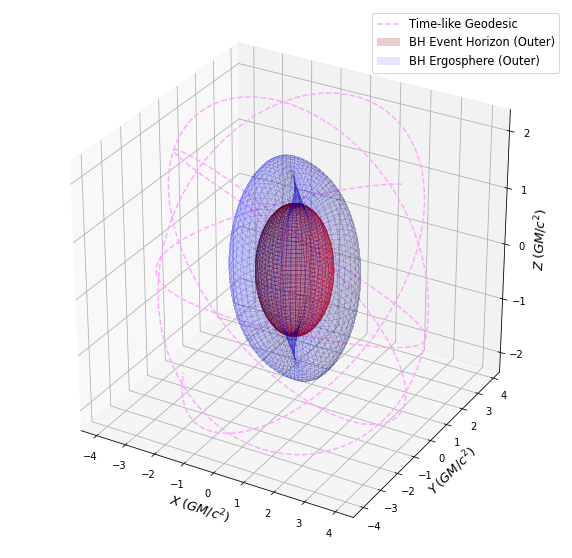

In [159]:
sgpl.plot(geod, figsize=(10, 10), color="#FAF")
sgpl.show()

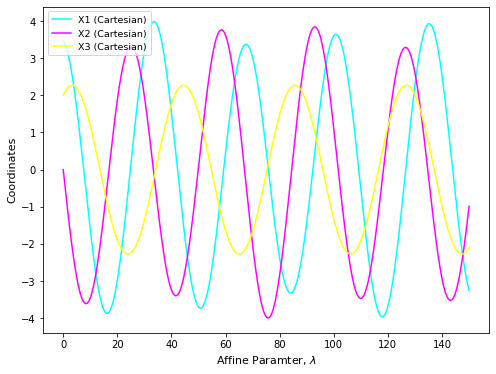

In [160]:
sgpl.parametric_plot(geod)
sgpl.show()

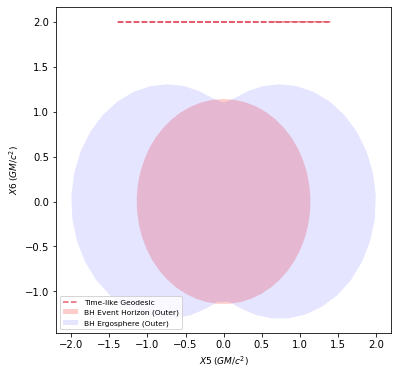

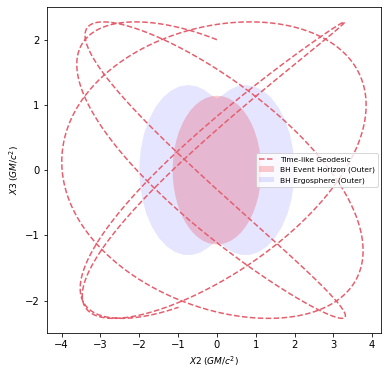

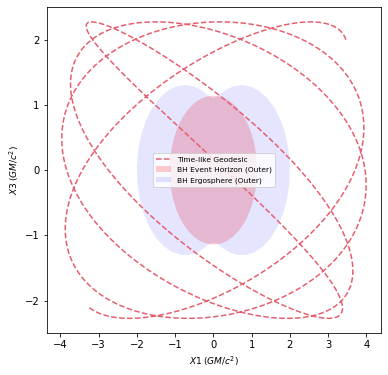

In [13]:
sgpl.plot2D(geod, (5, 6))
sgpl.show()
sgpl.plot2D(geod, (2, 3))
sgpl.show()
sgpl.plot2D(geod, (1, 3))
sgpl.show()

In [163]:
igpl.clear()
igpl.plot2D(geod, (1, 2))
igpl.show()

In [164]:
igpl.clear()
igpl.plot2D(geod, (2, 3))
igpl.show()

In [166]:
igpl.clear()
igpl.plot2D(geod, (1, 3))
igpl.show()

In [167]:
igpl.save()

In [72]:
igpl.clear()
igpl.parametric_plot(geod)
igpl.show()

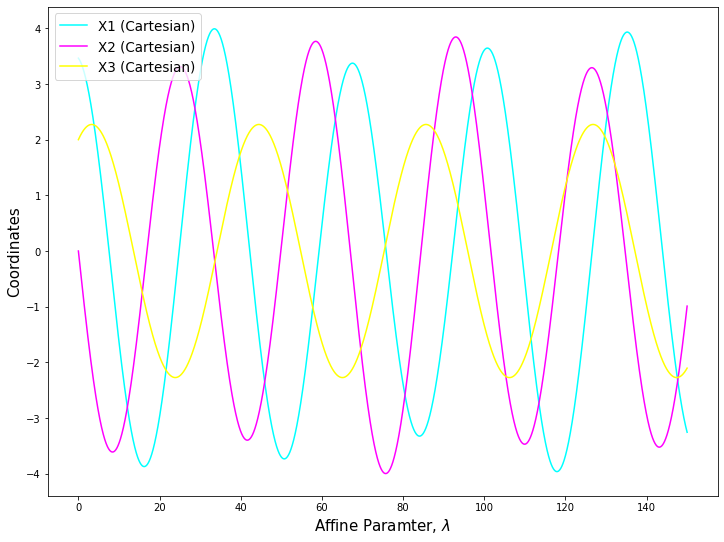

In [71]:
sgpl.parametric_plot(geod, figsize=(12, 9))
sgpl.show()